<a href="https://colab.research.google.com/github/samrakshanadhikari/Classification-and-Feature-importance./blob/main/landcover_texas.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

We first need to install all the requirements.  

In [ ]:
!pip install --quiet --upgrade pip

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 17.3 MB/s eta 0:00:00


In [ ]:
!pip install --quiet apache-beam
#Restart the runtime for ending process.
exit()


  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.4/17.4 MB 109.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.3/3.3 MB 102.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.7/5.7 MB 115.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.8/40.8 MB 80.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 63.5 MB/s eta 0:00:00
  DEPRECATION: Building 'crcmod' using the legacy setup.py bdist_wheel mechanism, which will be removed in a future version. pip 25.3 will enforce this behaviour change. A possible replacement is to use the standardized build interface by setting the `--use-pep517` option, (possibly combined with `--no-build-isolation`), or adding a `pyproject.toml` file to the source tree of 'crcmod'. Discussion can be found at https://github.com/pypa/pip/

In [ ]:
# 🌐 Configure Colab for Google Cloud + Earth Engine

# Use newer Python type annotation syntax (optional but safe)
from __future__ import annotations

import os
from google.colab import auth

# 🔐 Authenticate with your Google Account (will prompt login)
auth.authenticate_user()

# ✅ Your Google Cloud Project ID
project = "crucial-media-462807-e4"

# ⚠️ Safety check — this throws an error if project is still empty
assert project, "⚠️ Please provide a Google Cloud project ID"

# 🌍 Set environment variable so TensorFlow/Google libraries use the correct project
os.environ["GOOGLE_CLOUD_PROJECT"] = project

# 🔧 Tell the gcloud CLI to use your project
!gcloud config set project {project}


Updated property [core/project].


In [ ]:
!git clone https://github.com/GoogleCloudPlatform/python-docs-samples.git
%cd python-docs-samples/people-and-planet-ai/land-cover-classification


Cloning into 'python-docs-samples'...
remote: Enumerating objects: 123672, done.
remote: Counting objects: 100% (177/177), done.
remote: Compressing objects: 100% (96/96), done.
remote: Total 123672 (delta 125), reused 82 (delta 81), pack-reused 123495 (from 2)
Receiving objects: 100% (123672/123672), 259.86 MiB | 26.20 MiB/s, done.
Resolving deltas: 100% (74455/74455), done.
Updating files: 100% (5504/5504), done.
/content/python-docs-samples/people-and-planet-ai/land-cover-classification


In [ ]:
import ee
import google.auth

credentials, _ = google.auth.default()
ee.Initialize(
    credentials.with_quota_project(None),
    project=project,
    opt_url="https://earthengine-highvolume.googleapis.com",
)


Before we begin, let's start by looking at what we want to achieve and the datasets we chose.

A machine learning model is like a function, you give it some inputs and it returns you some predictions. But instead of having to write a lot of specialized code manually, you give it a bunch of training examples and it learns from them. To know what it should learn, you have to give it the correct output (also known as a label) for each input during training. A training example is a pair of (inputs, labels).

Let's train a simple model to do 🗺 land cover classifications, similar to Dynamic World. That means classifying each pixel in a map to show if it's water, grass, trees, bare ground, built-up, etc. Land cover is used in climate, energy, water, agriculture, conservation, and many other sectors. Many other models can be framed in a very similar way.

🌍 Earth Engine basics
Earth Engine combines petabytes of geospatial data, and a collection of functions to process and analyze it. We'll use the Earth Engine Python client library, but you can check the API Reference page to see other ways of using Earth Engine.

Here are some of the basic concepts to know of Earth Engine.

Band: A band is a matrix (like a 2D table) of pixel values. Each pixel in a band has a single numeric value (bytes, integers, floats, etc).
Image: Earth Engine images are made up of one or more bands, each one with their own name.
ImageCollection: A collection of zero or more images, similar to a list of images.
Geometry: Usually a point coordinate, a polygon, or multi-polygon.
Feature: Earth Engine features contain a value and a Geometry.
FeatureCollection: A collection of zero or more features, similar to a list of features.
Scale: The pixel resolution of an image, measured in meters.
🛰 Inputs: Sentinel 2 images
The inputs of the model are the data we want to give it every time we want a prediction from it.

To get good results from our model, we must provide it with good data. As a rule of thumb, if a human can solve a problem given some input data, a machine learning model will most likely be able to solve the problem as well.

After looking at some of the options in the Earth Engine data catalog, we decided to use the Sentinel-2 MultiSpectral satellite images. Sentinel 2 pictures at a 10 meter resolution roughly every five days for the same region. However, for simplicity, we'll be using 1-year composites instead of analyzing each individual image.

The Sentinel-2 satellites have multiple specialized sensors, each one capturing different ranges from the 🌈 electromagnetic spectrum. They can capture much more information than professional photography cameras. Typically, images consist of three values, or channels, (Red, Green, Blue) for every pixel. Sentinel-2 has 13 different values, or bands, for every pixel! For us humans, it's hard to visualize such a broad spectrum, but machine learning can learn the patterns behind them given enough training examples.

One common challenge when dealing with satellite imagery is that the Earth has ☁️ clouds, lots of them, especially in tropical areas. Clouds are great for rain and keeping our weather balanced, but when it comes to processing pictures taken from outer space, they're tricky to deal with.

Fortunately, many satellite images have metadata associated with their images to locate where there (probably) are clouds. For example, Sentinel-2 has a CLOUDY_PIXEL_PERCENTAGE property which tells us how much of an image is covered in clouds. Additionally, there's a QA60 (Quality Assurance) band, that's a bitmask which includes a couple bits to know if a pixel contains clouds or not.

We can mask (hide) pixels containing clouds in a Sentinel 2 image with this function

In [ ]:
import ee


def mask_sentinel2_clouds(image: ee.Image) -> ee.Image:
  ## The fuction removes clouds from sentinel-2 imgaes using QA60 band, which contains cloud flags.
    ## It takes one Sentinel-2 image as input.
    ## Returns a cloud-masked version of that image.


## This function is applied to every image in the Sentinel-2 ImageCollection, and within each image, it processes every pixel in the QA60 band to determine if it is cloudy or not.
    CLOUD_BIT = 10
    CIRRUS_CLOUD_BIT = 11
    bit_mask = (1 << CLOUD_BIT) | (1 << CIRRUS_CLOUD_BIT)
    mask = image.select("QA60").bitwiseAnd(bit_mask).eq(0)
    return image.updateMask(mask)

To get our Sentinel 2 yearly composite, first we take the Sentinel 2 ImageCollection. Then we filter the images to only keep the ones from the year of interest. Next we mask the cloudy pixels, select the bands we'll use, and take the median of all the non-cloudy pixels.

When we get the pixel values from Earth Engine, there might be areas that had clouds all year long like some areas in the tropics. Earth Engine still gives us the data, but any masked pixels will have a value of NaN (Not a Number). Our model will do strange things if we feed it NaNs or infinities, so let's get rid of them.

There are many ways of dealing with missing values, and it all depends on what you're trying to achieve. A common way is filling missing values with zero. Here, we have numeric data from light sensors, like a camera. It's unrealistic having zeroes like completely black objects absorbing everything. By analyzing the common data range and visualizing the data with different values for missing data, filling them with 1000 seemed like a good value. We used ee.Image.unmask to remove the mask from the image, and fill in the missing values with 1000.

Finally, Sentinel 2 saves the data as double (float64). But since machine learning is probabilistic, we don't need that much precision. Also, if we're trying to run our model in hardware accelerators, we usually have to convert our data to float32s anyway. So at the end, we convert the data to float32 as an optimization to make smaller data transfers and reduce the size of the training dataset.



In [ ]:
import ee


def get_input_image(year: int, default_value: float = 1000.0) -> ee.Image:
  ## Parameters are: year, and default value for missing pixels(due to clouds)and returns -> ee.image means returns an object of type ee.Image from Earth engine API.

   ## This function returns sentinel-2 composite images for a specific year. It handles cloud masking, band selection,a ggregation,and nmissing data filling.
    return (
        ## This ee.ImageCollection() accesses the sentinel-2 Harmonized image collection in earth engine. which includes surface reflectance data from Sentinel-2A and 2B
        ee.ImageCollection("COPERNICUS/S2_HARMONIZED")  # Sentinel-2 images
        .filterDate(f"{year}-1-1", f"{year}-12-31")  # filter by year
        .filter(ee.Filter.lt("CLOUDY_PIXEL_PERCENTAGE", 20))  # filter cloudy images
        .map(mask_sentinel2_clouds)  # mask/hide cloudy pixels
        .select("B.*")  # select all bands starting with B
        .median()  # median of all non-cloudy pixels
        .unmask(default_value)  # default value for masked pixels
        .float()  # convert to float32
    )

💡 ee.Image.select supports regular expressions. For example in B.*, it first matches the B. The . is a wildcard to match any character, and the * means zero or more of the ., so it matches B followed by zero or more of any character.

For visualization, bands (B4, B3, B2) correspond to (Red, Green, Blue) respectively. We can use Folium to visualize it as an interactive map. Here's an example image of a copper mine in Cananea, Sonora, Mexico.

In [ ]:
import folium

image = get_input_image(2020)
vis_params = {
    "min": 0,
    "max": 3000,
    "bands": ["B4", "B3", "B2"],
}
folium.Map(
    location=(30.95, -110.29),
    zoom_start=13,
    tiles=image.getMapId(vis_params)["tile_fetcher"].url_format,
    attr='Map Data &copy; <a href="https://earthengine.google.com/">Google Earth Engine</a>',
)

 Labels: Land cover map
The labels are the expected outputs of our model. We'll be pairing the labels with their respective inputs to create the training examples.

Machine learning models learn by example, so we need to show them how an actual land cover map looks like for a given patch of Sentinel-2 pixels.

Earth Engine has the European Space Agency WorldCover map, which is a 10 meter resolution land cover map of the entire world for the year 2020. It was actually derived from the Sentinel-2 images, that's why they both have a 10 meter resolution.

We only have data from 2020, so using the Sentinel-2 median for the entire year makes things easier. But our model, will be able to make predictions on data from years and regions it hasn't seen before during training.

Just like the input data, we also want to fill missing values. The land cover map only has data for the land, not for the oceans, so in this case we want to fill the missing values with water which is 0 in the way we encoded our classifications.

We also only have 9 classifications. A byte (unsigned 8-bit integer) can fit up to 2^8 (256) different values, way more than what we need to store just 9 values. So we convert the classifcations into bytes to optimize data transfers as well.

Here's how the same copper mine looks like in the land cover map.

In [ ]:
import ee
import folium

from visualize import CLASSIFICATIONS


def get_label_image() -> ee.Image:
    # Remap the ESA classifications into the Dynamic World classifications
    fromValues = [10, 20, 30, 40, 50, 60, 70, 80, 90, 95, 100]
    toValues = [1, 5, 2, 4, 6, 7, 8, 0, 3, 3, 7]
    return (
       ee.Image("ESA/WorldCover/v100/2020")

        .select("Map")

        .remap(fromValues, toValues)
        .rename("landcover")
        .unmask(0)  # fill missing values with 0 (water)
        .byte()  # 9 classifications fit into an unsinged 8-bit integer
    )


image = get_label_image()

vis_params = {
    "bands": ["landcover"],
    "max": len(CLASSIFICATIONS) - 1,
    "palette": list(CLASSIFICATIONS.values()),
}
folium.Map(
    location=(30.95, -110.29),
    zoom_start=13,
    tiles=image.getMapId(vis_params)["tile_fetcher"].url_format,
    attr='Map Data &copy; <a href="https://earthengine.google.com/">Google Earth Engine</a>',
)

We can see there's a clear distinction between the "natural world" and the "human-made world". The mining complex itself looks like bare ground, which makes sense since all the topsoil has been removed to scratch the inner minerals. The surrounding areas look like mostly shrub, scrub, grasses, and some trees. We can also see the built-up roads from the city of Cananea at the northern area.

There are multiple pools of leachate used for the ore extraction, classified as "water" by the land cover map.

In [ ]:
from visualize import show_legend

show_legend()

    💧 Water
    🌳 Trees
    🌾 Grass
    🌿 Flooded vegetation
    🚜 Crops
    🪴 Shrub and scrub
    🏗️ Built-up areas
    🪨 Bare ground
    ❄️ Snow and ice


The dataset is just a collection of (inputs, labels) pairs. Something to consider, is that we want a balanced dataset that has an even distribution between all the different cases we want our model to learn from. Having too many samples of one case and too few of another might lead to bias in our model.

📌 Sample points
"[Earth] is big. Really big. You just won't believe how vastly hugely mind-bogglingly big it is."

-- 🛸 Hitchhiker's Guide to the Galaxy -- Douglas Adams

The Earth might not be as big as space, but it still contains a huge amount of data. Sentinel-2 takes float64 numbers for each pixel with a 10 resolution, for 13 bands, for roughly every five days. Training on the entire world would not only use a huge amount of resources, it would take a very long time to finish.

A quick and statistically sound alternative, would be to randomly pick points and use those as our training data. That should be an evenly distributed set of points. But there's another problem, around 71% of the Earth's surface is water. That means that if our model guesses that everything is water, it would have 71% accuracy! Not too bad, right? 🤔

Fortunately, Earth Engine has a function called ee.Image.stratifiedSample that picks the same number of points for every classification in an ee.Image. We only have 9 classifications, so if we tell it to pick 100 points per classification, we would end up with a dataset of 900 examples.

In [61]:
from typing import Iterable


import ee
from google.colab import auth

auth.authenticate_user()
ee.Authenticate()  # You may need to run this once
ee.Initialize(project='crucial-media-462807-e4')




def sample_points(
    region: ee.Geometry, image: ee.Image, points_per_class: int, scale: int
):
    points = image.stratifiedSample(
        points_per_class,
        region=region,
        scale=scale,
        geometries=True,
    )
    for point in points.toList(points.size()).getInfo():
        yield point["geometry"]["coordinates"]


# Get Texas boundary from TIGER dataset
states = ee.FeatureCollection("TIGER/2018/States")
texas = states.filter(ee.Filter.eq('NAME', 'Texas')).geometry()

labels_image = get_label_image()  # Your function that returns the land cover image

for point in sample_points(texas, labels_image, points_per_class=2, scale=1000):
    print(point)


[-95.54488856350318, 28.785051061593606]
[-94.66453958506605, 32.82746984013146]
[-100.13527966535393, 29.845063096854645]
[-98.27576702722652, 28.308943961010264]
[-98.27576702722652, 26.943504729148593]
[-102.18343851314644, 36.48361304649791]
[-97.40440120163059, 26.26078511321775]
[-97.3954180487894, 26.943504729148593]
[-99.89273453864166, 28.946747812735126]
[-100.30595956933665, 33.20476225946165]
[-99.59629049488223, 28.85691628432317]
[-98.36559855563848, 27.95860100020365]
[-95.39217496520287, 30.096591376408114]
[-96.75761419706454, 33.17781280093807]
[-103.18955163136032, 29.422854913318467]
[-105.91144694224246, 31.632710512252494]


If you have a regression problem where you want to predict a number instead of a classification, you could convert the numbers to integers. If the numbers are too large, you could bucketize them by dividing them by a constant before converting them to integers.

📑 Get training examples
Now that we have all the point coordinates we want to get, we can fetch their surrounding patches from Earth Engine.

We use the ee.Image.getDownloadURL method to give us a download link to the patch pixels data as a NumPy array.

One thing to note is that since we'll be doing lots of requests in parallel, we'll most likely be getting errors with status 429: Too Many Requests from Earth Engine. We can safely retry the request if we get that error. A simple way to do it is with the google.api_core.retry library, but there's a catch. That library only understands exceptions from the google.api_core.exceptions library. To quickly fix this, if we get a status 429 error, we can simply raise the appropriate google.api_core exception.

In [62]:
import io
import numpy as np
import requests
from google.api_core import exceptions, retry


@retry.Retry(deadline=10 * 60)  # seconds
def get_patch(
    image: ee.Image, lonlat: tuple[float, float], patch_size: int, scale: int
) -> np.ndarray:
    point = ee.Geometry.Point(lonlat)
    url = image.getDownloadURL(
        {
            "region": point.buffer(scale * patch_size / 2, 1).bounds(1),
            "dimensions": [patch_size, patch_size],
            "format": "NPY",
        }
    )

    # If we get "429: Too Many Requests" errors, it's safe to retry the request.
    # The Retry library only works with `google.api_core` exceptions.
    response = requests.get(url)
    if response.status_code == 429:
        raise exceptions.TooManyRequests(response.text)

    # Still raise any other exceptions to make sure we got valid data.
    response.raise_for_status()
    return np.load(io.BytesIO(response.content), allow_pickle=True)

 If you need, you can request an increase of quota of the number of concurrent requests you can make. For more information, see the High-volume endpoint page.

Note that Earth Engine returns the data as a structured array. You can think of structured arrays similar to a multidimensional Pandas DataFrame, or spreadsheet. They're like a "table" containing multidimensional data. We want dense tensors instead of structured arrays, so we use structured_to_unstructured and the bands automatically go to an extra dimension at the end.

Now, let's create some helper functions to get the inputs and labels patches of pixels. We'll use this function both for getting inputs for the training examples, and for predictions later on.

In [63]:
from numpy.lib.recfunctions import structured_to_unstructured


def get_input_patch(
    year: int, lonlat: tuple[float, float], patch_size: int
) -> np.ndarray:
    image = get_input_image(year)
    patch = get_patch(image, lonlat, patch_size, scale=10)
    return structured_to_unstructured(patch)


def get_label_patch(lonlat: tuple[float, float], patch_size: int) -> np.ndarray:
    image = get_label_image()
    patch = get_patch(image, lonlat, patch_size, scale=10)
    return structured_to_unstructured(patch)

💡 It's very important to use input data for predictions in exactly the same format than the one used for training. Sharing the same function for both makes sure they're the same.

It would also be useful to create a function to get a whole training example. Since we only have labels for year 2020, we don't need to ask for the year for the inputs.

In [64]:
def get_training_example(
    lonlat: tuple[float, float], patch_size: int = 128
) -> tuple[np.ndarray, np.ndarray]:
    return (
        get_input_patch(2020, lonlat, patch_size),
        get_label_patch(lonlat, patch_size),
    )


point = 	(-97.7431, 30.2672)# (lon, lat)
(inputs, labels) = get_training_example(point)
print(f"inputs : {inputs.dtype} {inputs.shape}")
print(f"labels : {labels.dtype} {labels.shape}")

inputs : float32 (128, 128, 13)
labels : uint8 (128, 128, 1)


In [65]:
from visualize import show_example

show_example(inputs, labels)

✍🏽 Serialize to TFRecords
Finally, since we'll be training a TensorFlow model, it would be good to write our datasets as TFRecords. To use other frameworks like PyTorch, scikit-learn, or XGBoost we could use any other file format that's easieast for us, like compressed NumPy files.

For TFRecords, we have to convert our data into a tf.train.Example. It consists of a dictionary of tf.Features (different to ee.Features), where each tf.Feature can be a list of bytes, floats, or int64s. Note that it can only save flat lists, so it won't save the shapes. As a workaround, we use tf.io.serialize_tensor to first serialize our dense tensors into bytes including their shape information. As an added benefit, serialized tensors are a space efficient binary format.

Then we save one tf.Feature for the inputs, and another one for the outputs. Finally, we serialize the entire tf.Example into bytes.

In [66]:
import tensorflow as tf


def serialize(inputs: np.ndarray, labels: np.ndarray) -> bytes:
    features = {
        name: tf.train.Feature(
            bytes_list=tf.train.BytesList(value=[tf.io.serialize_tensor(data).numpy()])
        )
        for name, data in {"inputs": inputs, "labels": labels}.items()
    }
    example = tf.train.Example(features=tf.train.Features(feature=features))
    return example.SerializeToString()


serialized = serialize(inputs, labels)
print(f"serialized: {len(serialized)} bytes")

serialized: 868448 bytes


🗃 Create the dataset
We have all the pieces now, so lets put all together into an Apache Beam pipeline. Apache Beam allows us to create parallel processing pipelines.

The pipeline uses FlatMap to sample balanced points on our region of interest. Then it Maps the get_training_example function, which gets us a pair of (inputs, labels). Finally, we serialize them to TFRecords and write them to compressed TFRecord files with WriteToTFRecord.

Running this locally works great for testing things out with small datasets, but for larger datasets we should be using a distributed runner like Dataflow.

In [68]:
import apache_beam as beam
from apache_beam.options.pipeline_options import PipelineOptions
import ee

# Initialize Earth Engine (make sure to authenticate and initialize before this)
ee.Initialize(project='crucial-media-462807-e4')


# Texas polygon coordinates (approximate boundary)
texas_coords = [[
    [-106.645646, 31.895754],  # SW corner
    [-93.508292, 31.895754],   # SE corner
    [-93.508292, 36.500704],   # NE corner
    [-106.645646, 36.500704],  # NW corner
    [-106.645646, 31.895754],  # back to SW corner to close polygon
]]

# Create EE polygon geometry for Texas
region = ee.Geometry.Polygon(texas_coords)

labels_image = get_label_image()

with beam.Pipeline() as pipeline:
    (
        pipeline
        | "🗺 Create Texas region" >> beam.Create([region])
        | "📌 Sample points"
        >> beam.FlatMap(sample_points, labels_image, points_per_class=1, scale=1000)
        | "📑 Get examples" >> beam.Map(get_training_example)
       | "✍🏽 Serialize" >> beam.MapTuple(serialize)
       | "📚 Write TFRecords"
        >> beam.io.WriteToTFRecord("data/part", file_name_suffix=".tfrecord.gz")

    )


The next step is to define a function to parse and read the serialized tf.Examples and give us back the original `(inputs, labels)` pair.
First we use [`tf.io.parse_single_example`](https://www.tensorflow.org/api_docs/python/tf/io/parse_single_example) to parse the tf.Example using a tf.Features dictionary.
Both the _inputs_ and _labels_ are a simple `tf.string` since they're serialized, so we use [`tf.io.parse_tensor`](https://www.tensorflow.org/api_docs/python/tf/io/parse_tensor) to parse the individual _inputs_ and _labels_ tensors, each one with their respective data types.

Since we're parsing serialized tensors, TensorFlow isn't able to infer the shapes of the dataset, so we have to set them explicitly.
The patch size is variable sized, so we use `None`, but the number of inputs and outputs are constants we must provide.

Finally, the model expects classifications as [one-hot](https://en.wikipedia.org/wiki/One-hot) encoded vectors, instead of integers.
We use [`tf.one_hot`](https://www.tensorflow.org/api_docs/python/tf/one_hot) to convert them.

In [69]:
!ls -lh data/*.tfrecord.gz

-rw-r--r-- 1 root root 2.4M Jun 18 00:56 data/part-00000-of-00001.tfrecord.gz


🧠 Train the model
We finally have a dataset of training examples on which to train the model. The overall process of training the model is pretty straightforward, but there's a lot of things to know on how to set it up.

First, some basic definitions:

🔮 Model: You can think of the model as a function. You give it some inputs and it returns you some outputs. But rather than writing the function yourself, it learns from examples.
🧮 Tensor: Tensors are 🌌 multi-dimensional numbers. Scalars have 0 dimensions. Vectors have 1 dimension. Matrices have 2 dimensions. Tensors can have any number of dimensions. Machine learning models take tensors as inputs and return tensors.
🏗️ Shape: This says how many dimensions and how they look. For example, a 3x4 matrix has shape (3, 4), and an 800x600 RGB image has a shape (800, 600, 3), because it has three numbers (red, green, blue) for every pixel.


📖 Read the dataset
Let's start by looking at the data files that we just created. We can use tf.data.TFRecordDataset to read the TFRecord files, but we'll get bytes for each element.



In [70]:
import tensorflow as tf

filenames = tf.data.Dataset.list_files(f"data/*.tfrecord.gz")
dataset = tf.data.TFRecordDataset(filenames, compression_type="GZIP")

# We get bytes directly from the TFRecords.
for x in dataset.take(1):
    print(f"{type(x.numpy()).__name__} {len(x.numpy())}")

bytes 868448


The next step is to define a function to parse and read the serialized tf.Examples and give us back the original (inputs, labels) pair. First we use tf.io.parse_single_example to parse the tf.Example using a tf.Features dictionary. Both the inputs and labels are a simple tf.string since they're serialized, so we use tf.io.parse_tensor to parse the individual inputs and labels tensors, each one with their respective data types.

Since we're parsing serialized tensors, TensorFlow isn't able to infer the shapes of the dataset, so we have to set them explicitly. The patch size is variable sized, so we use None, but the number of inputs and outputs are constants we must provide.

Finally, the model expects classifications as one-hot encoded vectors, instead of integers. We use tf.one_hot to convert them.


[ ]


In [71]:
NUM_INPUTS = 13
NUM_CLASSES = 9


def read_example(serialized: bytes) -> tuple[tf.Tensor, tf.Tensor]:
    features_dict = {
        "inputs": tf.io.FixedLenFeature([], tf.string),
        "labels": tf.io.FixedLenFeature([], tf.string),
    }
    example = tf.io.parse_single_example(serialized, features_dict)
    inputs = tf.io.parse_tensor(example["inputs"], tf.float32)
    labels = tf.io.parse_tensor(example["labels"], tf.uint8)

    # TensorFlow can't infer the shapes, so we set them explicitly.
    inputs.set_shape([None, None, NUM_INPUTS])
    labels.set_shape([None, None, 1])

    # Classifications are measured against one-hot encoded vectors.
    one_hot_labels = tf.one_hot(labels[:, :, 0], NUM_CLASSES)
    return (inputs, one_hot_labels)


filenames = tf.data.Dataset.list_files(f"data/*.tfrecord.gz")
dataset = tf.data.TFRecordDataset(filenames, compression_type="GZIP").map(read_example)

for inputs, labels in dataset.take(1):
    print(f"inputs : {inputs.dtype.name} {inputs.shape}")
    print(f"labels : {labels.dtype.name} {labels.shape}")

inputs : float32 (128, 128, 13)
labels : float32 (128, 128, 9)


 Split the dataset
But during training, our model might be memorizing the dataset and give us weird results when we try to get predictions on data it has never seen before. For this reason, it's common to split our dataset into a training dataset and a testing (validation) dataset.

The training dataset is what the model uses to learn and adjust itself. It goes through this dataset multiple times, each time it goes through the entire dataset is called an epoch.

The testing (or validation) dataset is used like an exam. It's important that the testing dataset does not include examples found in the training dataset, or the validation will be biased. After going through the training dataset, the model will check itself against the testing dataset, which should include data it has not seen (learned from) before.

You can choose how much data to use for training and for testing, 80% for training and 20% for testing, or 90% for training and 20% for testing are common choices. Since we're experimenting with a really small dataset, we'll go with 90% to maximize the training data.

Finally, we also shuffle the training dataset, and batch both datasets. There's no need to shuffle the testing dataset. Models always expect batches of inputs instead of individual inputs.

In [72]:
BATCH_SIZE = 8
TRAIN_TEST_RATIO = 90  # percent for training, the rest for testing


def split_dataset(dataset: tf.data.Dataset) -> tuple[tf.data.Dataset, tf.data.Dataset]:
    indexed_dataset = dataset.enumerate()  # add an index to each example
    train_dataset = (
        indexed_dataset.filter(lambda i, _: i % 100 <= TRAIN_TEST_RATIO)
        .map(lambda _, data: data)  # remove index
        .shuffle(BATCH_SIZE * 8)  # randomize the examples for the batches
        .batch(BATCH_SIZE)  # batch randomized examples
    )
    test_dataset = (
        indexed_dataset.filter(lambda i, _: i % 100 > TRAIN_TEST_RATIO)
        .map(lambda _, data: data, num_parallel_calls=tf.data.AUTOTUNE)  # remove index
        .batch(BATCH_SIZE)  # batch the parsed examples, no need to shuffle
    )
    return (train_dataset, test_dataset)


(train_dataset, test_dataset) = split_dataset(dataset)
for inputs, labels in train_dataset.take(1):
    print(f"inputs : {inputs.dtype.name} {inputs.shape}")
    print(f"labels : {labels.dtype.name} {labels.shape}")

inputs : float32 (8, 128, 128, 13)
labels : float32 (8, 128, 128, 9)


💡 If you want to learn more on how to optimize your TensorFlow datasets, see the Better performance with the tf.data API guide.

Note that when we batch examples together, we get an extra dimension at the beginning. So now our input shapes are (batch_size, patch_size, patch_size, inputs).

🏛 Model architecture (optional)
When we define the input shapes of our model in TensorFlow Keras, we omit the batch size since it assumes it'll always be there.

The model is typically implemented as layers. A simple approach is having all the layers chained one after the other. But we could come up with all sorts of architectures.

💡 If you're already familiar with the concepts of machine learning, feel free to skip this section.

Input layers

Now we know that our model accepts inputs as a dense tensor with shape (patch_size, patch_size, num_input_bands) and returns us land cover probabilities with shape (patch_size, patch_size, num_classes). We want the patch_size to be variable sized, so we can pass patches of pixels of any size into it. In TensorFlow Keras, None means it's a variable sized dimension, so our inputs would be of shape (None, None). We create an Input layer for every input band where we define the input shapes. An Input layer doesn't transform the data in any way.

In [73]:
tf.keras.Input(shape=(None, None, NUM_INPUTS), name="inputs")

<KerasTensor shape=(None, None, None, 13), dtype=float32, sparse=False, name=inputs>

We got shapes (None, None, None, 13) for each input even though we defined them with shape (None, None, 13). That's expected, Keras always inserts a new dimension for the batch size, so our inputs in reality are of shape (batch_size, patch_size, patch_size, 13).

Preprocessing layers

The Sentinel-2 sensors also save their data in a range roughly between 0 and 10,000, but that varies depending on each measuring instrument.

Machine learning doesn't like large numbers, they tend to make the model less stable and makes it hard for it to learn. Ideally we want small numbers, roughly inbetween -1 and 1. It doesn't have to be too strict, having slightly larger or smaller numbers from time to time won't hurt. Since we're just dealing with numeric data, we can use a Normalization layer which analyzes the training dataset and figures out how to scale them, then it automatically scales the values as part of the model!

This means we can pass the model the raw Sentinel-2 data, rather than relying on us humans to scale the data in exactly the same way it was scaled during training.

⚠️ Always analyze only the training dataset, never the validation dataset. Looking into the validation dataset creates bias on the model. It's like letting someone peek into an exam, and then taking that same exam.

In [74]:
# Adapt the Normalization layer with the training dataset.
normalization = tf.keras.layers.Normalization()
normalization.adapt(train_dataset.map(lambda inputs, _: inputs))

# Here's the mean from the training dataset.
print(f"mean : {normalization.mean.shape}")
print(normalization.mean.numpy())

# Here's the variance from the training dataset.
print(f"variance : {normalization.variance.shape}")
print(normalization.variance.numpy())

mean : (1, 1, 1, 13)
[[[[1515.5673   1351.3275   1345.152    1431.4121   1614.6309
    2100.9697   2385.5796   2322.4233   2614.9321    836.33826
      15.443401 2342.5195   1454.6675  ]]]]
variance : (1, 1, 1, 13)
[[[[1.5386570e+05 2.6318650e+05 3.9248209e+05 7.0774469e+05
    5.9279975e+05 5.1417372e+05 6.2021938e+05 6.1643175e+05
    7.7034438e+05 1.1137560e+05 1.4220359e+01 9.9566431e+05
    7.9002294e+05]]]]


Note that it found 13 mean values and 13 variance values. That means each input band has its own scaling values. So it doesn't matter if one band has value ranges between 0 and 1, while other band has a range between 5,000 and 100,000.

Let's give it a "patch" containing a single pixel of Sentinel-2 data to see how it looks like after normalizing it.

In [75]:
raw_values = [
    [[[1212, 1057, 1095, 1392, 1428, 1602, 1732, 1660, 1789, 1044, 22, 2349, 1619]]]
]
print(normalization(raw_values).numpy())

[[[[-0.7738985  -0.5737188  -0.39929515 -0.04684803 -0.24239825
    -0.6958558  -0.8299001  -0.8437099  -0.9410266   0.6222451
     1.7386947   0.00649456  0.18488584]]]]


All the values are nice and small, perfect for the next layer in our model.

💡 The Normalization layer is one of TensorFlow Keras preprocessing layers. To learn more about other preprocessing layers and how to use them, see the Working with preprocessing layers guide.

Activation functions

Each layer has to communicate with the next layer. The simplest approach is passing the output value from one layer directly into the next layer, this is called a linear activation. For example, we don't really want to modify the values returned by our preprocessing layers.

However, sometimes it helps applying a simple function before passing the data to the next layer. This is inspired by how the synapses work in the brain. In a nutshell, one neuron receives an electrical signal from many other neurons connected to it. If the total electric charge is above a certain threshold, it fires an electric signal (synapse) to other neurons. Our model architectures are not nearly as complex as evan a simple brain, but it turns out that many of these ideas still work well.

As a rule of thumb, a relu activation usually works well for most hidden layers. It roughly mimicks how synapses work. If an output value is positive it passes through unmodified (synapse), otherwise it's truncated to zero (no synapse).

💡 To learn more about the available activation functions, see the tf.keras.activations module.

In [76]:
inputs = tf.stack([[-3.0, -1.0, 0.0, 1.0, 3.0]])

print(f"inputs:  {inputs}")
print(f"linear:  {tf.keras.activations.linear(inputs)}")
print(f"relu:    {tf.keras.activations.relu(inputs)}")
print(f"softmax: {tf.keras.activations.softmax(inputs)}")

inputs:  [[-3. -1.  0.  1.  3.]]
linear:  [[-3. -1.  0.  1.  3.]]
relu:    [[0. 0. 0. 1. 3.]]
softmax: [[0.00205549 0.01518815 0.04128566 0.11222605 0.8292446 ]]


Convolutional layers

To classify one pixel, it's useful to also see at the surrounding pixels. The shapes and patterns around it might tell us more information. Convolutional layers do exactly that. During training, it's like they were making a stencil and modifying it until it matches every pixel. That "stencil" is called the kernel and we have to tell it the size of the kernel to use. Since we only have two variable-sized dimensions, the width and the height of the patch, we can use a Conv2D layer. For example, if we have a kernel size of 5, we would be classifying the center pixel, and we would be using a padding of 2 pixels on each side. But what happens at the edges of the image? The kernel usually doesn't go beyond the image's bounds to capture the corner. Instead, it simply returns a smaller image, but can compensate by returning a deeper image. This is controlled by the number of filters of the layer. For example, if we started with a (256, 256, 13) image, with a kernel size of 5 and 32 filers, we would end up with a (252, 252, 32) image.

We ended up with a smaller patch of deeper data, but we want the model to return a patch of exactly the same size as our inputs. Fortunately, we can use a Conv2DTranspose layer to get back to the original shape we had. They're also known as Inverse Convolutional or Deconvolutional layers. They do the inverse as a Convolutional layer, so instead of shrinking the patch, they expand the patch. They also need to know a kernel size and the number of filters to control the depth. If we want the same patch size, we have to make sure to use the same kernel size on both the Conv2D and Conv2DTranspose. For example, if we started with a (252, 252, 32) image, with a kernel size of 5 and 16 filters, we would end up with a (256, 256, 16) image.

These layers inbetween the input and output layers are usually called hidden layers. This is because they're part of the "black box" inside of the model and don't affect it's external interface. They do affect how the data and shapes are transformed inside of the model, and they mostly define the architecture of the model.

💡 To learn more about the available layers, see the tf.keras.layers module.

In [77]:
# This is how we create a 2D Convolutional layer.
tf.keras.layers.Conv2D(filters=32, kernel_size=5, activation="relu")

<Conv2D name=conv2d_1, built=False>

In [78]:
# This is how we create a 2D Transpose Convolutional layer.
tf.keras.layers.Conv2DTranspose(filters=16, kernel_size=5, activation="relu")

<Conv2DTranspose name=conv2d_transpose_1, built=False>

💡 Even though convolutional layers can accept variable-sized inputs, the kernel_size defines the minimum size of the accepted images. For example, if you have a kernel size of 5, you must give an image of at least 5x5 pixels so the kernel can fit at least once.

Output layer

Finally, the output layer changes a lot depending on what we're trying to do. We usually use a simple Dense layer for outputs. What changes is the activation function.

Regression: To predict a numeric value, we use a Dense layer with a single output and linear activation. We want to leave the predicted value as it is.
Binary classification: To classify either one thing or another, we use a Dense layer with a single output and sigmoid activation. We want to scale the output between 0 and 1. For example, if we want to predict if it will rain or not, we can interpret the resulting value as the probability of rain.
Multi-class classification: To classify one of more than two possibilities, we use a Dense layer with the same outputs as we have classifications, and a softmax activation. We want to scale each output into values between 0 and 1 such that the sum of all of them is 1, this is called a probability distribution.
In our case, we are doing multi-class classification since we have 9 possible land cover classifications. So we need a Dense layer with 9 outputs (units), and a softmax activation.

In [79]:
# Dense output layer for multi-class classification.
tf.keras.layers.Dense(NUM_CLASSES, activation="softmax")

<Dense name=dense_1, built=False>

Optimizers and loss functions

Before we can train our model, we first have to compile it. Now we need to tell it what optimizer and loss function to use.

First, here's a high-level overview of what happens when we train a model. It first usually starts at a random state. Then, the model:

Reads a batch from the training dataset.
Processes the inputs and returns some outputs.
Compares its outputs with the expected outputs in the dataset.
Adjusts itself so it would give a slightly better answer next time on those inputs.
Repeats this until it goes through the entire training dataset, this is what we call an epoch.
Each time it goes through an epoch, it checks how it does with new data in the validation dataset.
It does not learn from the validation dataset, it's simply to test how it does with data it's never seen before.
We typically train the model for hundreds or thousands of epochs to get a good model.
But how does the model know if what it predicted was good or not? And how does the model "adjusts itself" to give better answers next time?

🏔 Let's say you're in the backcountry, and you want to climb the tallest mountain. You decide to score your mountain-climbing by the elevation you get, higher elevations have a smaller error than lower elevations.

You start your journey at a random place. Most likely not the top of a tall mountain, so your error is probably pretty high.

It's a slightly foggy day, so you can kind of recognize some shapes of what might be mountains, but you can't see the entire horizon. From the places you can see, you decide to drive to an area with a high potential of being the highest. On your way there you go up and down some smaller hills, but you decide to keep going anyways, even if that means going downhill.

As you start reaching the mountain base of your destination, the fog gradually gets denser so you can't see as much. Driving is no longer an option and you start hiking. You follow the slope to go uphill and minimize the error.

Eventually, you reach the highest point visible to you. You've reached your optimization goal!

There could be a higher point somewhere else, but you can't see it with all that fog. What a day to go for that view!

The model learns using the backpropagation algorithm guided by gradient descent, similar to finding the highest point of the mountain.

The model consists of layers, and each layer has weights. Those are the adjustable parameters that change as the model is training. The key question is deciding which weights to update and by how much. Should they be increased or decreased? Slightly or by a lot? Should I update the first layers, or the last, or all of them?

Backpropagation helps to decide which weights to adjust to decrease the error, regardless of the layer they're at. Before backpropagation, models with more than a couple layers were not practical.

During training, the optimizer can't know where the smallest error is without really trying it out, represented by the fog in our story. It uses gradient descent to determine in which direction to move in order to decrease the error, like looking at the slope of the mountain. It hints the model where to go and by how much to increase or decrease each weight.

It's the job of the optimizer to decide how fast to go, like going by car or going by foot in our story. This is controlled by the learning rate. Usually optimizers start with a relatively large learning rate, which allows the model to jump and explore far away areas quickly in search for promising areas. The fog is not very thick and see where we want to go without paying too much attention to the slope. As the training progresses, it gradually reduces the learning rate to move more slowly and avoid jumping over the optimum. The fog gets thicker and we walk slowly, paying more attention to the slope.

To compare how good the results were, we need a function to measure the error, or loss, from the model's results compared to the labeled results in the training dataset. This measures the magnitude of the error so the higher the error, the more aggressively the model adjusts its weights.

Just like the output layers, this changes depending on what we're trying to do. Here's a table summarizing what to do on each case.

Goal	Outputs	Activation	Loss function
Regression	1	linear	mean_squared_error
Binary classification	1	sigmoid	binary_crossentropy
Multi-class classification	num_classes	softmax	categorical_crossentropy
💡 For more information on the available loss functions, see the tf.keras.losses module.

🐣 Create the model
After the long explanation, here's how the final model architecture would look like.
https://github.com/GoogleCloudPlatform/python-docs-samples/blob/main/people-and-planet-ai/land-cover-classification/images/model-architecture.png?raw=1

And this is how it looks in code. Fortunately, it's a lot smaller than the previous explanations.




Model: "FullyConvolutionalNetwork"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ normalize (Normalization)       │ (None, None, None, 13) │            27 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2D (Conv2D)                 │ (None, None, None, 32) │        10,432 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ deconv2D (Conv2DTranspose)      │ (None, None, None, 16) │        12,816 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ landcover (Dense)               │ (None, None, None, 9)  │           153 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 23,428 (91.52 KB)

 Trainable params: 23,401 (91.41 KB)

 Non-trainable params: 27 (112.00 B)

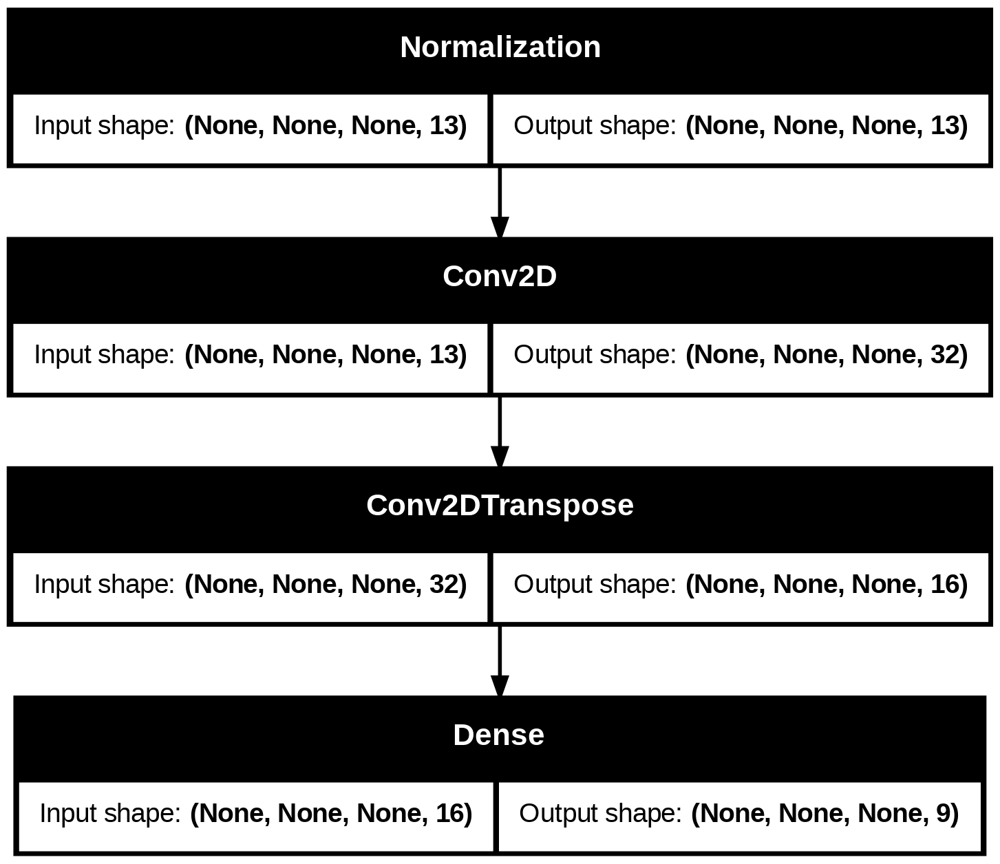

In [80]:
KERNEL_SIZE = 5

# Adapt the Normalization layer with the training dataset.
normalization = tf.keras.layers.Normalization(name="normalize")
normalization.adapt(train_dataset.map(lambda inputs, _: inputs))

# Define the Fully Convolutional Network.
model = tf.keras.Sequential(
    [
        tf.keras.Input(shape=(None, None, NUM_INPUTS), name="inputs"),
        normalization,
        tf.keras.layers.Conv2D(32, KERNEL_SIZE, activation="relu", name="conv2D"),
        tf.keras.layers.Conv2DTranspose(
            16, KERNEL_SIZE, activation="relu", name="deconv2D"
        ),
        tf.keras.layers.Dense(NUM_CLASSES, activation="softmax", name="landcover"),
    ],
    name="FullyConvolutionalNetwork",
)

model.summary()
tf.keras.utils.plot_model(model, show_shapes=True)

Optimizers play an important role in how fast the model learns and how stable they are, so how do you know if you're using the right one? Fortunately there's a simple rule of thumb. Try the Adam optimizer first, that should be good enough for most use cases.

💡 According to Kingma et al., 2014, the method (Adam optimizer) is "computationally efficient, has little memory requirement, invariant to diagonal rescaling of gradients, and is well suited for problems that are large in terms of data/parameters". (source)

💡 For more information on the available optimizers, see the tf.keras.optimizers module.

We can compile the model by letting it know which optimizer to use, which loss function to use for each output, and optionally the metrics we want to track.

In [81]:
model.compile(
    optimizer="adam",
    loss="categorical_crossentropy",
    metrics=[
        tf.keras.metrics.OneHotIoU(
            num_classes=NUM_CLASSES,
            target_class_ids=list(range(NUM_CLASSES)),
        )
    ],
)

💡 We are using OneHotIoU (Intersection-Over-Union) as a metric, which is a common evaluation metric for semantic image segmentation.

Finally, we can train the model. To train the model, we use the tf.keras.Model.fit method.

We need to at least point it to the training and validation datasets. We shuffle the training dataset to keep each epoch a little more randomized.

By default, it trains the model on a single epoch, but it's a good idea to train on more epochs to get better results.

In [82]:
!gsutil ls -b gs://crucial-media-462807-e4


BucketNotFoundException: 404 gs://crucial-media-462807-e4 bucket does not exist.


In [92]:
import os
os.makedirs("model", exist_ok=True)  # creates 'model' directory if not exist


In [93]:
# Train the model.
model.fit(train_dataset, validation_data=test_dataset, epochs=10)

# Save it as files.
model.save("model/my_model.keras")


Epoch 1/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 774ms/step - loss: 1.1056 - one_hot_io_u_1: 0.4224
Epoch 2/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 743ms/step - loss: 1.0616 - one_hot_io_u_1: 0.4474
Epoch 3/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 1.0193 - one_hot_io_u_1: 0.4647   
Epoch 4/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.9786 - one_hot_io_u_1: 0.4802   
Epoch 5/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 0.9384 - one_hot_io_u_1: 0.5016
Epoch 6/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step - loss: 0.9012 - one_hot_io_u_1: 0.5281   
Epoch 7/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step - loss: 0.8663 - one_hot_io_u_1: 0.5531
Epoch 8/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step - loss: 0.8290 - one_hot_io_u_1: 0.5663
Epoch 9/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 927ms/step - loss: 0.7926 - one_hot_io_u_1: 0.5720
Epoch 10/10
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 760ms/step - loss: 0.7620 - one_hot_io_u_1: 0.5623


In [96]:
!ls -lh model/

total 304K
-rw-r--r-- 1 root root 304K Jun 18 01:04 my_model.keras


In [99]:
model = tf.keras.models.load_model("model.keras")


In [102]:
model = tf.keras.models.load_model("model.keras")


In [121]:
from visualize import show_inputs

# List of Texas city coordinates (longitude, latitude)
texas_coords = [
    (-95.36, 29.76),     # Houston
    (-97.9172, 29.8833), # San Marcos
    (-96.7970, 32.7767), # Dallas
    (-97.7431, 30.2672), # Austin
]

for coord in texas_coords:
    print(f"Showing patch at coordinate: {coord}")
    inputs = get_input_patch(2018, coord, patch_size=512)
    show_inputs(inputs)


Showing patch at coordinate: (-95.36, 29.76)


Showing patch at coordinate: (-97.9172, 29.8833)


Showing patch at coordinate: (-96.797, 32.7767)


Showing patch at coordinate: (-97.7431, 30.2672)


In [109]:
import numpy as np

# We had a single input, so grab the first element from the predictions.
print(f"inputs : {inputs.dtype.name} {inputs.shape}")
probabilities = model.predict(np.stack([inputs]))[0]
print(f"probabilities : {probabilities.dtype} {probabilities.shape}")

inputs : float32 (512, 512, 13)
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 999ms/step
probabilities : float32 (512, 512, 9)


In [110]:
predictions = probabilities.argmax(axis=-1).astype(np.uint8)
print(f"predictions : {predictions.dtype} {predictions.shape}")

predictions : uint8 (512, 512)


In [125]:
from visualize import show_inputs, show_outputs
import numpy as np

# Coordinates you are testing
texas_coords = [
    (-95.36, 29.76),     # Houston
    (-97.9172, 29.8833), # San Marcos
    (-96.7970, 32.7767), # Dallas
    (-97.7431, 30.2672), # Austin
]

for coord in texas_coords:
    print(f"Processing coordinate: {coord}")

    inputs = get_input_patch(2018, coord, patch_size=512)
    show_inputs(inputs)

    inputs_batch = np.expand_dims(inputs, axis=0)
    predictions = model.predict(inputs_batch)

    pred_img = predictions[0]

    if pred_img.ndim == 3 and pred_img.shape[-1] > 1:
        pred_class = np.argmax(pred_img, axis=-1)
    else:
        pred_class = pred_img.astype(np.int32)

    print(f"Showing land cover prediction for coordinate: {coord}")
    show_outputs(pred_class[:, :, None])


Processing coordinate: (-95.36, 29.76)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Showing land cover prediction for coordinate: (-95.36, 29.76)


Processing coordinate: (-97.9172, 29.8833)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Showing land cover prediction for coordinate: (-97.9172, 29.8833)


Processing coordinate: (-96.797, 32.7767)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
Showing land cover prediction for coordinate: (-96.797, 32.7767)


Processing coordinate: (-97.7431, 30.2672)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   
Showing land cover prediction for coordinate: (-97.7431, 30.2672)
